## Airline Satisfaction Prediction Project


**Importing Libraries into the notebook**

In [3]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import ConfusionMatrixDisplay 




**Importing Datasets**

In [153]:
df = pd.read_csv('data/train.csv') 

**Displays the overview information:**

In [154]:
df.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [155]:
df.dtypes

Unnamed: 0                             int64
id                                     int64
Gender                                object
Customer Type                         object
Age                                    int64
Type of Travel                        object
Class                                 object
Flight Distance                        int64
Inflight wifi service                  int64
Departure/Arrival time convenient      int64
Ease of Online booking                 int64
Gate location                          int64
Food and drink                         int64
Online boarding                        int64
Seat comfort                           int64
Inflight entertainment                 int64
On-board service                       int64
Leg room service                       int64
Baggage handling                       int64
Checkin service                        int64
Inflight service                       int64
Cleanliness                            int64
Departure 

**Drop unnecessary column as it a repeat of the index and not needed for modeling**

In [156]:
df.drop('Unnamed: 0', axis=1, inplace=True) 

In [157]:
df['Gender'].head()

0      Male
1      Male
2    Female
3    Female
4      Male
Name: Gender, dtype: object

**Shape**

In [158]:
df.shape

(103904, 24)

**Checking for missing Values**

In [159]:
df.isna().sum()

id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction                           0
dtype: int64

**Fill the missing values with median**

In [160]:
# Calculate the median of the 'Arrival Delay in Minutes' column
median_arrival_delay = df['Arrival Delay in Minutes'].median()

In [161]:
# Fill the missing values with the median
df['Arrival Delay in Minutes'].fillna(median_arrival_delay, inplace=True)

/var/folders/r6/5h8mbndn785665_tjqm9h5d00000gn/T/ipykernel_41272/311242456.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Arrival Delay in Minutes'].fillna(median_arrival_delay, inplace=True)


**Changing the column name to lower case**

In [162]:
df.columns =df.columns.str.lower()

**Let's confirm if the changes have been made**

In [163]:
df.columns

Index(['id', 'gender', 'customer type', 'age', 'type of travel', 'class',
       'flight distance', 'inflight wifi service',
       'departure/arrival time convenient', 'ease of online booking',
       'gate location', 'food and drink', 'online boarding', 'seat comfort',
       'inflight entertainment', 'on-board service', 'leg room service',
       'baggage handling', 'checkin service', 'inflight service',
       'cleanliness', 'departure delay in minutes', 'arrival delay in minutes',
       'satisfaction'],
      dtype='object')

# Exploratory Data Analysis (EDA) using Plotly 


**1.Visulization: Pie Distribution of Satisfaction**

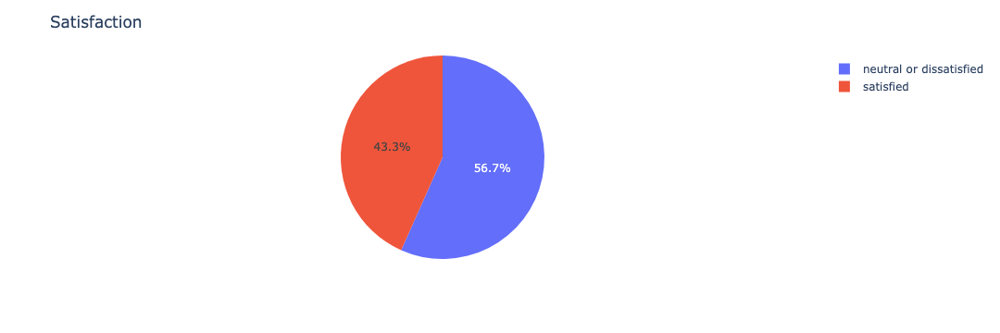

In [169]:
# Distribution of Satisfaction
fig = px.pie(df, names='satisfaction')
                
fig.update_layout(title='Satisfaction')

The chart shows that among passengers, 56.7% reported being "neutral or dissatisfied" while 43.3% were "satisfied" . Let's investigate further to see the reason behind this.

**2.Visulization: Boxplot of flight distance vs.Satisfaction**

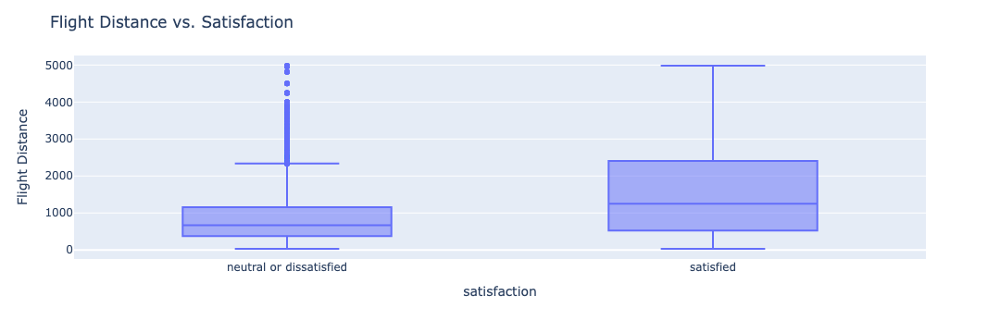

In [165]:
# # Box plot of Flight Distance vs. Satisfaction
fig = px.box(df, x='satisfaction', y='flight distance') 
    
fig.update_layout(title='Flight Distance vs. Satisfaction',
                  xaxis_title = 'satisfaction',
                  yaxis_title = 'Flight Distance')
  

fig.show()


This chart shows that customers that were satisfied had the tendency to travel long distancethan those who were neutral or dissatisfied.The dissatisfied group also showed a much larger range of flight distances.

**3.Visulization:Count plot of Class vs. Satisfaction**

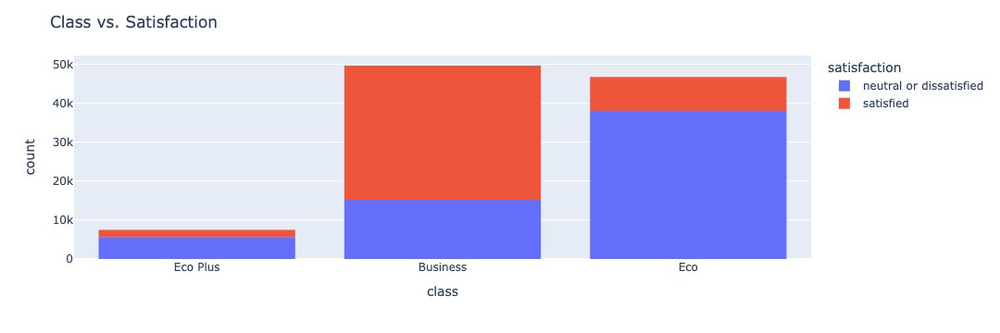

In [166]:
# Count plot of Class vs. Satisfaction
fig = px.histogram(df, x='class', color='satisfaction')

fig.update_layout(title='Class vs. Satisfaction')

fig.show()

The chart demonstrates that business class passengers have significantly higher satisfaction compared to Eco and Eco Plus passengers. Class is a strong indicator of customer satisfaction in this dataset.

**4.Visulization:Box plot of Inflight Wifi Service vs. Satisfaction**

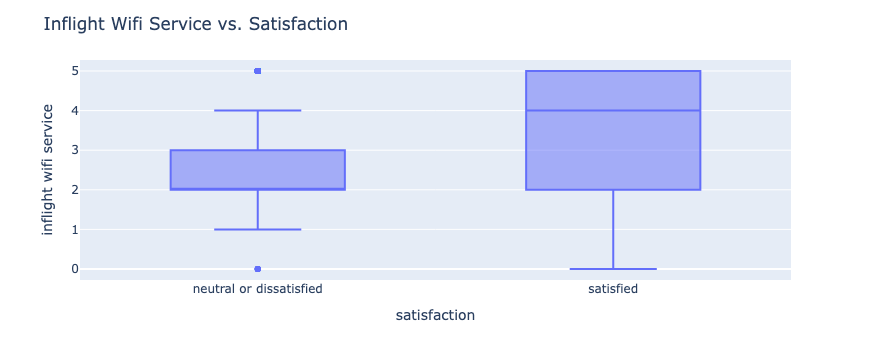

In [172]:
# Box plot of Inflight Wifi Service vs. Satisfaction
fig = px.box(df, x='satisfaction', y='inflight wifi service') 
                 
fig.update_layout(title='Inflight Wifi Service vs. Satisfaction')            
    
fig.show()

The boxplot shows a positive correlation between inflight wifi service ratings and customer satisfaction, with satisfied customers generally reporting higher wifi ratings. Customers who reported a low score, were generally not satisfied.

**5. Correlation Matrix**

**5.Scatterplot to show Depature Delay vs Arrival Delay with Satisfaction in color**

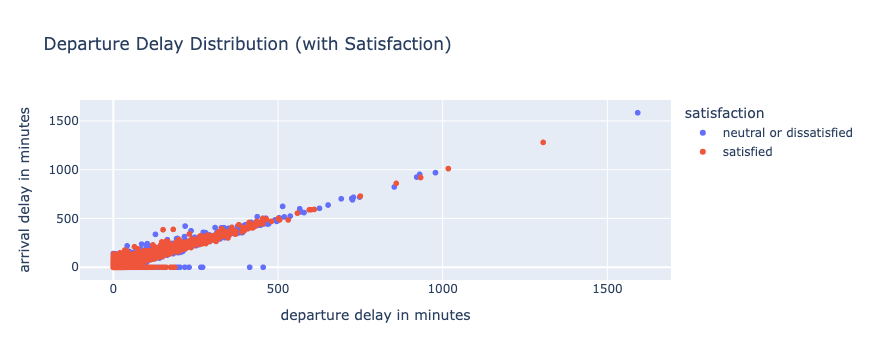

In [175]:
# Create a histogram of 'departure delay in minutes'
fig = px.scatter(df,
                     x='departure delay in minutes',
                      y = 'arrival delay in minutes',
                     color='satisfaction',
                     title='Departure Delay Distribution (with Satisfaction)')


fig.show()

The scatter plot demonstrates a strong positive correlation between departure and arrival delays, with dissatisfied customers often experiencing longer delays.

**Converting Categorical columns to numerical columns for Modeling**

**Converting Satisfaction columns - 'neutral or dissatisfied as '0', satisfied as '1'**

In [22]:
df['satisfaction'] = df['satisfaction'].map({'neutral or dissatisfied': 0, 'satisfied': 1})


In [23]:
df['satisfaction'].map

<bound method Series.map of 0         0
1         0
2         1
3         0
4         1
         ..
103899    0
103900    1
103901    0
103902    0
103903    0
Name: satisfaction, Length: 103904, dtype: int64>

**Converting Gender columns- Male :1, Female : 2**

In [24]:
df['gender'].head(15)

0       Male
1       Male
2     Female
3     Female
4       Male
5     Female
6       Male
7     Female
8     Female
9       Male
10    Female
11    Female
12      Male
13      Male
14    Female
Name: gender, dtype: object

In [25]:
df['gender'] = df['gender'].map({'Male': 1, 'Female': 2})

Checking if it has converted

In [26]:
df['gender'].map

<bound method Series.map of 0         1
1         1
2         2
3         2
4         1
         ..
103899    2
103900    1
103901    1
103902    2
103903    1
Name: gender, Length: 103904, dtype: int64>

In [27]:
df.dtypes

id                                     int64
gender                                 int64
customer type                         object
age                                    int64
type of travel                        object
class                                 object
flight distance                        int64
inflight wifi service                  int64
departure/arrival time convenient      int64
ease of online booking                 int64
gate location                          int64
food and drink                         int64
online boarding                        int64
seat comfort                           int64
inflight entertainment                 int64
on-board service                       int64
leg room service                       int64
baggage handling                       int64
checkin service                        int64
inflight service                       int64
cleanliness                            int64
departure delay in minutes             int64
arrival de

**Converting Customer type- Loyal Customer -1, Disloyal Customer -0**

In [28]:
df['customer type'] = df['customer type'].map({'Loyal Customer': 1, 'disloyal Customer': 0})

In [29]:
df['customer type'].map

<bound method Series.map of 0         1
1         0
2         1
3         1
4         1
         ..
103899    0
103900    1
103901    0
103902    0
103903    1
Name: customer type, Length: 103904, dtype: int64>

**Converting Class - Business-1, Eco Plus-2, Eco-3**

In [30]:
df['class'] = df['class'].map({'Business': 1,'Eco Plus' : 2, 'Eco': 3})

In [31]:
df['class'].map

<bound method Series.map of 0         2
1         1
2         1
3         1
4         1
         ..
103899    3
103900    1
103901    1
103902    3
103903    1
Name: class, Length: 103904, dtype: int64>

In [32]:
df['type of travel'] = df['type of travel'].map({'Personal Travel':1, 'Business travel' :2})

**Checking to see if the categorical columns have been replaced with numerical**

In [33]:
df.head(15)

,id,gender,customer type,age,type of travel,class,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,...,inflight entertainment,on-board service,leg room service,baggage handling,checkin service,inflight service,cleanliness,departure delay in minutes,arrival delay in minutes,satisfaction
0,70172,1,1,13,1,2,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,0
1,5047,1,0,25,2,1,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,0
2,110028,2,1,26,2,1,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,1
3,24026,2,1,25,2,1,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,0
4,119299,1,1,61,2,1,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,1
5,111157,2,1,26,1,3,1180,3,4,2,...,1,3,4,4,4,4,1,0,0.0,0
6,82113,1,1,47,1,3,1276,2,4,2,...,2,3,3,4,3,5,2,9,23.0,0
7,96462,2,1,52,2,1,2035,4,3,4,...,5,5,5,5,4,5,4,4,0.0,1
8,79485,2,1,41,2,1,853,1,2,2,...,1,1,2,1,4,1,2,0,0.0,0
9,65725,1,0,20,2,3,1061,3,3,3,...,2,2,3,4,4,3,2,0,0.0,0


**Saving the cleaned data set**

In [36]:
df.to_csv('data/clean_train.csv', index=False)

## Predictive Modeling (Classification Modeling)

**Load the cleaned data set**

In [214]:
clm = pd.read_csv('data/clean_train.csv')

In [215]:
clm=clm.drop(columns='id')

**HEATMAP**

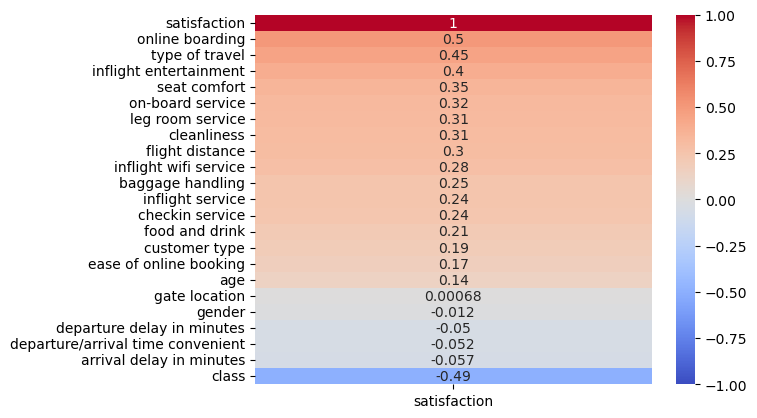

In [216]:
sns.heatmap(clm.corr(numeric_only = True)[['satisfaction']].sort_values(by='satisfaction', ascending=False),
            vmin = -1,
            vmax = 1,
            annot = True,
            cmap= 'coolwarm');
            

In [217]:
clm.dtypes

gender                                 int64
customer type                          int64
age                                    int64
type of travel                         int64
class                                  int64
flight distance                        int64
inflight wifi service                  int64
departure/arrival time convenient      int64
ease of online booking                 int64
gate location                          int64
food and drink                         int64
online boarding                        int64
seat comfort                           int64
inflight entertainment                 int64
on-board service                       int64
leg room service                       int64
baggage handling                       int64
checkin service                        int64
inflight service                       int64
cleanliness                            int64
departure delay in minutes             int64
arrival delay in minutes             float64
satisfacti

**Baseline Model**

In [218]:
clm['satisfaction'].value_counts(normalize = True)

satisfaction
0    0.566667
1    0.433333
Name: proportion, dtype: float64

**We want to get a model that has a higher accuracy than 56.6%**

## Train/Test Split

In [219]:
X = clm.drop(columns='satisfaction')
y = clm['satisfaction']

In [220]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify = y)

## Use StandardScaler to standardizes features

In [242]:
sc = StandardScaler()

X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.transform(X_test)

Let's Insitatiate K Nearest Neighbors (KNN)

In [222]:
knn = KNeighborsClassifier()

## Let's fit the model to X_train_sc and y_train and score it on Z_test_sc, y_test

In [223]:
# Fit
knn.fit(X_train_sc, y_train)

KNeighborsClassifier()

In [224]:
# Training accuracy score
knn.score(X_train_sc, y_train)

0.9477851349964069

In [225]:
#Testing accucary score

knn.score(X_test_sc, y_test)

0.9272405297197412

## Evalualting the model using Confusion Matrix

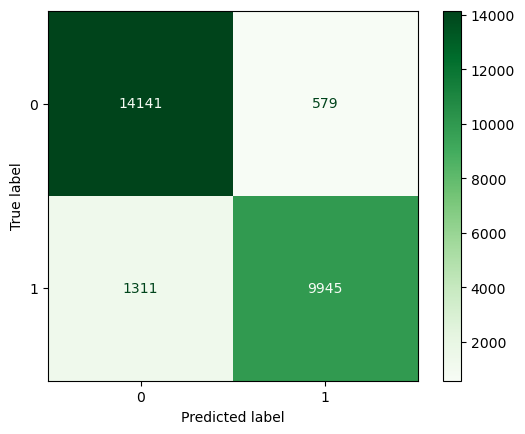

In [226]:
# Confusion Matrix
ConfusionMatrixDisplay.from_estimator(knn, X_test_sc, y_test, cmap = 'Greens');

This confusion matrix evaluates a model predicting 'neutral or dissatisfied' (0) and 'satisfied' (1). It accurately predicted 14,141 as 'neutral or dissatisfied' and 9,945 as 'satisfied', but misclassified 579 as 'satisfied' and 1,311 as 'neutral or dissatisfied'. The model favors predicting 'neutral or dissatisfied', struggling more with 'satisfied' classifications.

In [227]:
knn = KNeighborsClassifier(n_neighbors = 5)

knn.fit(X_train_sc, y_train)

knn.score(X_test_sc, y_test)

0.9272405297197412

In [228]:
scores = []

for k in range(3, 32, 2):
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train_sc, y_train)
    train_score = knn.score(X_train_sc, y_train)
    test_score = knn.score (X_test_sc, y_test)

    scores.append({'k' : k, 'train_score': train_score, 'test_score' : test_score})

df_score = pd.DataFrame(scores)



In [229]:
df_score

,k,train_score,test_score
0,3,0.957923,0.925393
1,5,0.947785,0.927241
2,7,0.943153,0.926586
3,9,0.939765,0.926317
4,11,0.937725,0.925662
5,13,0.936044,0.926240
6,15,0.934568,0.925855
7,17,0.933516,0.925701
8,19,0.932476,0.924892
9,21,0.931347,0.925046


The best value for K is 5. 5 has the highest score 0.926

In [ ]:
Lets visualize this

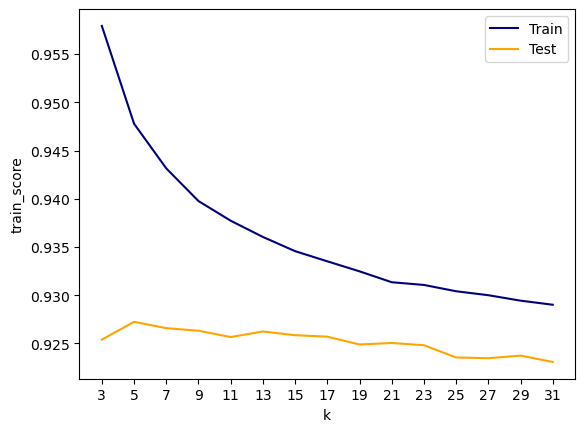

In [230]:
#visualize

sns.lineplot(data =df_score,x ='k', y ='train_score',c ='navy', label = 'Train')
sns.lineplot(data = df_score, x = 'k', y = 'test_score', c= 'orange', label = 'Test')
plt.xticks(range(3, 32, 2));

The plot shows that the model is overfitting, and k=5 is the best choice for the KNN classifier in this case.

## Classification Model-Logistic Regression

In [250]:
logr = LogisticRegression(max_iter=10000)

In [251]:
logr.fit(X_train, y_train)

LogisticRegression(max_iter=10000)

In [252]:
print(logr.feature_names_in_)

['gender' 'customer type' 'age' 'type of travel' 'class' 'flight distance'
 'inflight wifi service' 'departure/arrival time convenient'
 'ease of online booking' 'gate location' 'food and drink'
 'online boarding' 'seat comfort' 'inflight entertainment'
 'on-board service' 'leg room service' 'baggage handling'
 'checkin service' 'inflight service' 'cleanliness'
 'departure delay in minutes' 'arrival delay in minutes']


In [253]:
logr.score(X_train, y_train)

0.8744738733189611

In [254]:
logr.score(X_test, y_test)

0.8761934093008932

## Evaluate by using Confusion Matrix

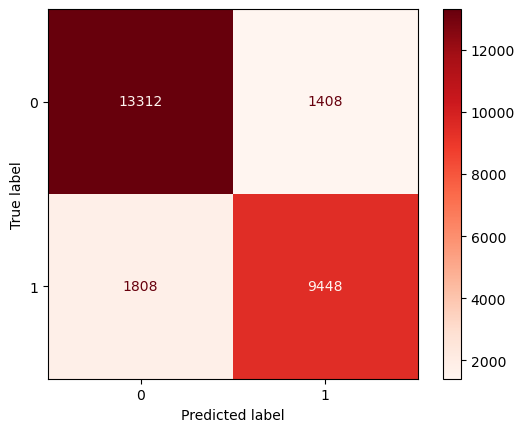

In [255]:
ConfusionMatrixDisplay.from_estimator(logr, X_test, y_test, cmap = 'Reds')

This confusion matrix shows a binary classification model's performance. It reveals the counts of true negatives (13312), false positives (1408), false negatives (1808), and true positives (9448). The matrix highlights the model's ability to correctly and incorrectly classify instances of two classes (0-'neutral-disatisfied' and 1-'satisfied'), aiding in performance evaluation. It also shows a class imbalance towards class 0('nuetral disatisfied').

## Random Forest Model:

In [237]:
rf = RandomForestClassifier(random_state = 42)

In [238]:
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [239]:
rf.score(X_train, y_train)

1.0

In [240]:
rf.score(X_test, y_test)

0.9607714813674161

Evalute using ConfusionMatrix

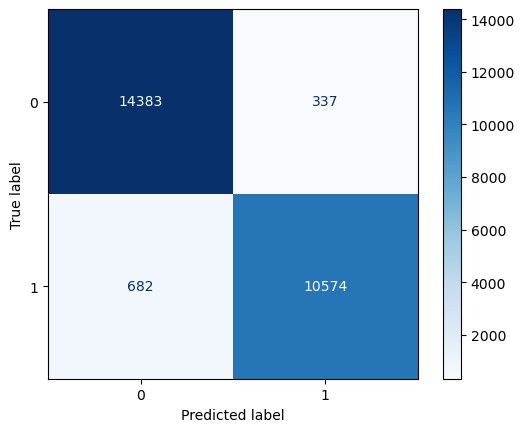

In [241]:
ConfusionMatrixDisplay.from_estimator(rf, X_test, y_test, cmap = 'Blues');

This confusion matrix, created from a Random Forest model, reveals the model's classification performance. It shows the count of correctly predicted 'nuetral dissatisfied'(14383) and 'satisfied' (10574) instances, along with the misclassifications (337 and 682). The matrix visually summarizes the model's accuracy and errors in distinguishing between the two classes.

**Conclusion**

Random Forest is the best model among the three, achieving the highest testing accuracy.
KNN also performs well, but Random Forest edges it out.
Logistic Regression has the weakest performance.
